In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
import anndata as ad
import matplotlib.pyplot as plt
import matplotlib.patches as patches

from tifffile import imread, imwrite
from skimage.measure import regionprops
from tqdm.notebook import tqdm
from anndata import AnnData


In [2]:
base_path = '/home/unix/jiahao/wanglab/Data/Analyzed/2024-02-23-Hongyu-Covid_Spleen_replicate_2/'
image_path = os.path.join(base_path, 'images')
signal_path = os.path.join(base_path, 'signal')
output_path = os.path.join(base_path, 'output')
expr_path = os.path.join(base_path, 'expr')
if not os.path.exists(expr_path):
    os.mkdir(expr_path)

## Generate h5ad

In [3]:
sample_dict = {}
sample_dict["sample1"] = [i for i in range(1, 429 + 1)]
sample_dict["sample2"] = [i for i in range(430, 735 + 1)]
sample_dict["sample3"] = [i for i in range(736, 1096 + 1)]

In [3]:
sample_dict = {}
sample_dict["sample4"] = [i for i in range(1, 401 + 1)]
sample_dict["sample5"] = [i for i in range(402, 706 + 1)]
sample_dict["sample6"] = [i for i in range(707, 1078 + 1)]

In [4]:
condition_dict = {
    'sample1': 'LNA',
    'sample2': "GG",
    'sample3': "PolyC",
}

In [5]:
for current_sample in tqdm(np.unique(list(sample_dict.keys()))):
    print(current_sample)

    adata_list = []
    for i in tqdm(sample_dict[current_sample]):
        current_fov = f"Position{i:03}"
        adata = sc.read_h5ad(os.path.join(expr_path, current_fov, f'raw.h5ad'))

        # combine Ms4a1 and Ms4a1-1
        adata.var_names_make_unique()
        adata[:, 'Ms4a1'].X = adata[:, 'Ms4a1'].X + adata[:, 'Ms4a1-1'].X
        adata = adata[:, adata.var_names != 'Ms4a1-1']

        adata_list.append(adata)

    cdata = ad.concat(adata_list, index_unique="_")
    cdata.obs['condition'] = cdata.obs['sample'].values
    cdata.obs['condition'] = cdata.obs['condition'].map(condition_dict)
    cdata.obs['condition'] = cdata.obs['condition'].astype('category')
    cdata.obs['sample'] = cdata.obs['sample'].astype('category')

    cdata.write_h5ad(os.path.join(expr_path, f'{current_sample}_raw.h5ad'))

    

  0%|          | 0/3 [00:00<?, ?it/s]

sample4


  0%|          | 0/401 [00:00<?, ?it/s]

/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site

sample5


  0%|          | 0/305 [00:00<?, ?it/s]

/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site

sample6


  0%|          | 0/372 [00:00<?, ?it/s]

/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site

## Viualization

In [6]:
current_sample = "sample4"  
adata = sc.read_h5ad(os.path.join(expr_path, f'{current_sample}_raw.h5ad'))

# calculate pp metric
sc.pp.calculate_qc_metrics(adata, inplace=True, percent_top=None)

# Normalization scaling
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
adata.raw = adata

# Scale data to unit variance and zero mean
sc.pp.scale(adata)
adata.layers['scaled'] = adata.X.copy()

adata

/home/unix/jiahao/anaconda3/envs/starfinder/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


AnnData object with n_obs × n_vars = 1294803 × 61
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z', 'condition', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'log1p'
    layers: 'scaled'

In [7]:
fig_size = np.array([adata.obs['global_x'].max(), adata.obs['global_y'].max()]) / 1000
plt.style.use("default")

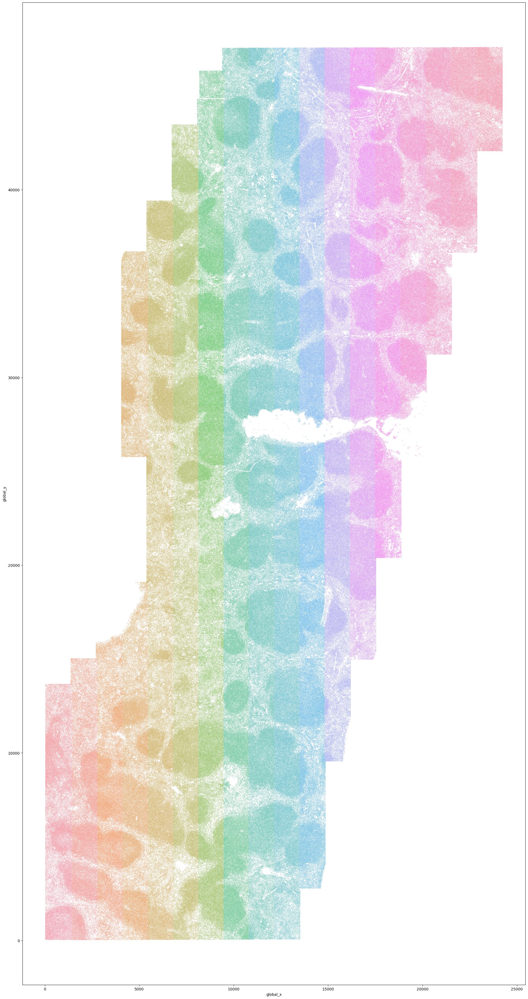

In [8]:
# Plot the FOVs
fig, ax = plt.subplots(figsize=fig_size)
sns.scatterplot(x='global_x', y='global_y', hue='fov_id', data=adata.obs, s=1, legend=False, ax=ax)
plt.show()

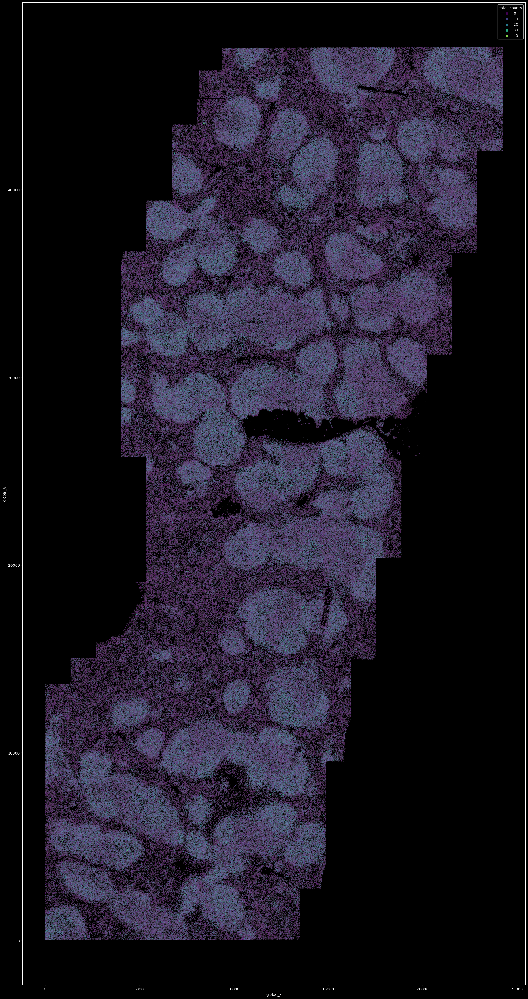

In [9]:
# Plot total_counts
plt.style.use("dark_background")
fig, ax = plt.subplots(figsize=fig_size)
sns.scatterplot(x='global_x', y='global_y', hue='total_counts', data=adata.obs, s=1, palette='viridis', ax=ax)
plt.show()

## check log

In [43]:
positions = [d for d in os.listdir(expr_path) if "Position" in d]

total_assignment = []
total_coverage = []

for current_position in tqdm(positions):
    current_log = os.path.join(expr_path, current_position, 'log.txt')  
    with open(current_log, 'r') as f:
        lines = [line.rstrip() for line in f]
        current_assignment = lines[0].split('%')[0]
        current_coverage = lines[1].split(' ')[2].split('%')[0]
        total_assignment.append(float(current_assignment))
        total_coverage.append(float(current_coverage))

        if float(current_coverage) > 100:
            print(current_position, current_assignment)

  0%|          | 0/1096 [00:00<?, ?it/s]

Position021 77.59
Position249 80.28
Position325 55.96
Position531 81.58
Position372 57.58
Position1008 64.22
Position637 75.84
Position779 72.77
Position1085 72.52
Position178 64.02
Position048 59.75
Position084 72.64
Position1050 75.05
Position170 72.44
Position016 70.49
Position811 76.99
Position899 73.58
Position191 83.82
Position1055 75.35
Position355 71.07
Position010 77.71
Position112 71.63
Position069 64.17
Position1095 72.72
Position059 81.51
Position417 72.86
Position047 74.47
Position621 74.90
Position812 74.13
Position886 77.58
Position008 60.28
Position558 80.49
Position005 70.41
Position513 76.61
Position395 75.77
Position782 74.12
Position494 75.01
Position455 77.39
Position659 83.11
Position819 78.87
Position064 67.17
Position676 80.76
Position186 79.01
Position409 62.80
Position050 58.18
Position917 74.27
Position431 73.51
Position520 77.16
Position508 77.92
Position063 63.88
Position252 82.92
Position751 62.43
Position274 61.64
Position560 78.29
Position913 71.92
Posit

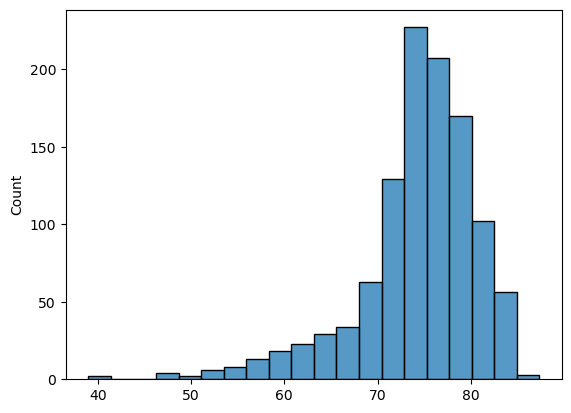

In [44]:
plt.style.use("default")
sns.histplot(total_assignment, bins=20)
plt.show()

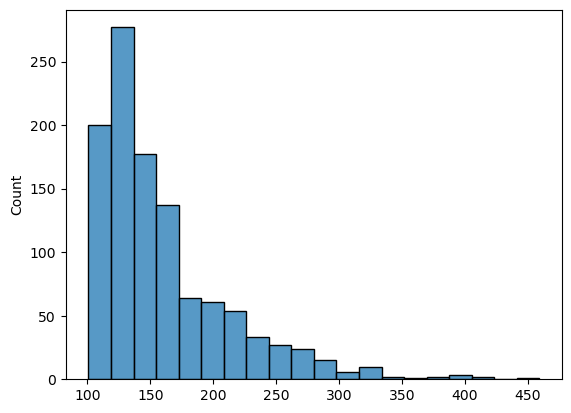

In [41]:
sns.histplot(total_coverage, bins=20)
plt.show()

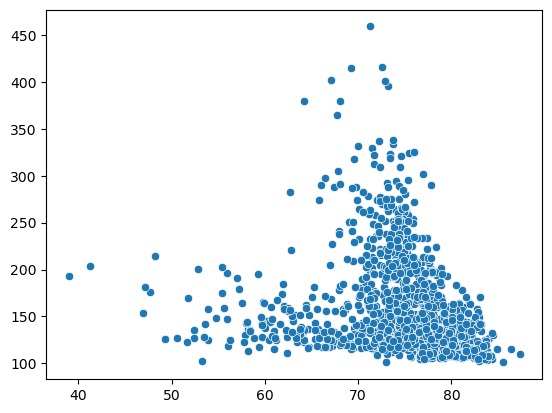

In [42]:
sns.scatterplot(x=total_assignment, y=total_coverage)
plt.show()